# Outline:
Introduction
- Delta Hedging
- Heston Model (Dynamics, Value, Delta, Simulation)

Variance Swap
- Payoff
- Strike Price Calculation
- Notional Calculation
- Running value

Analysis
- Assumptions (Costs, spred, Vswap tc, Heston Parameters)
- With vs Without vswap
    - Visualization 1: over different amount of vega hedged
    - Visualization 2: 2 plots, w/ vs w/o
    - over different Maturities
    - Over differnt volatilities
    - Over different volvol
    - Over different Hedging Steps

Earings Gap
- How earnings gap are modeled here
- With vs Without vswap

Conclusion

---


In [6]:
import matplotlib.pyplot as plt
import numpy as np

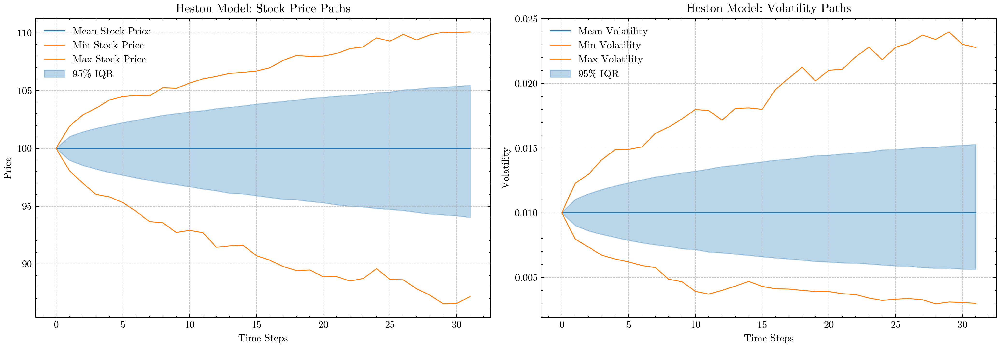

Vswap expected cost: -0.0


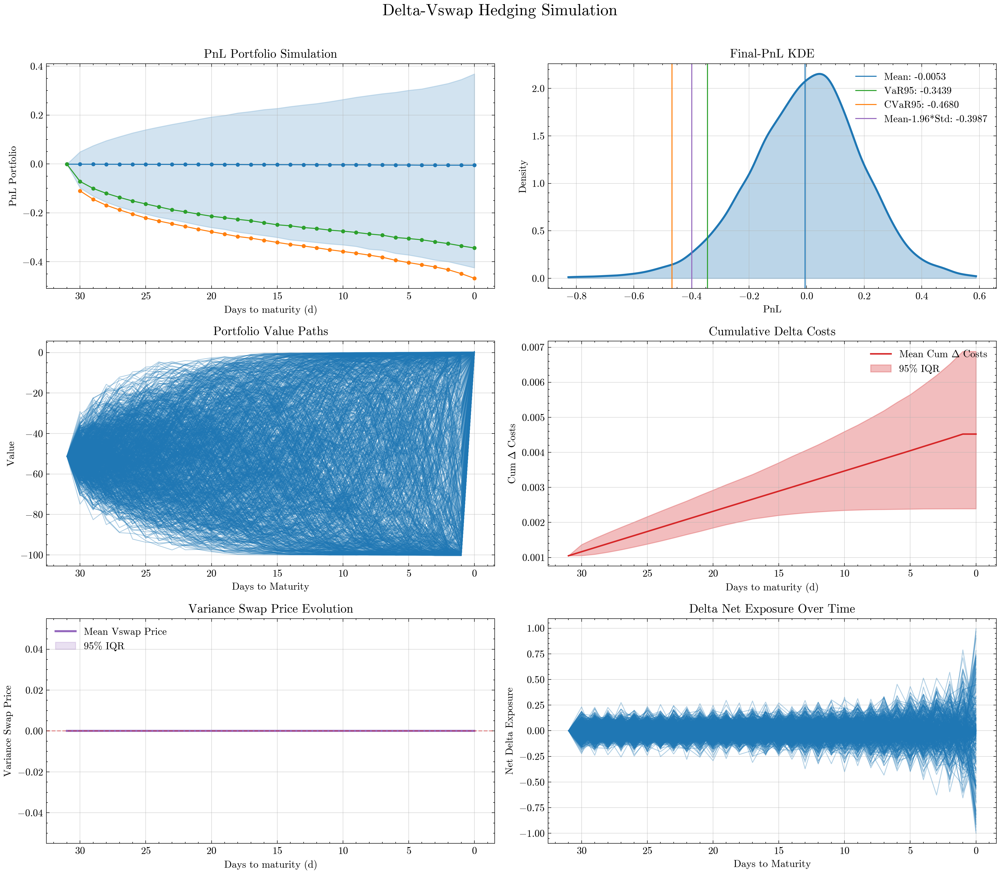

Option Price :  1.15883, Spread Earned: 0.00579
PnL mean     : -0.005305  CI [-0.00922,-0.00145]
PnL std      :  0.200697
VaR95        : -0.3439  CI [-0.3542,-0.3342]
CVaR95       : -0.4680  CI [-0.4834,-0.4516]
Mean Δ cost  :  0.004521
Vswap Notiona: 0.0000  Strike: 0.0101
Mean Swap PnL: 0.0000 CI [0.0000,0.0000]


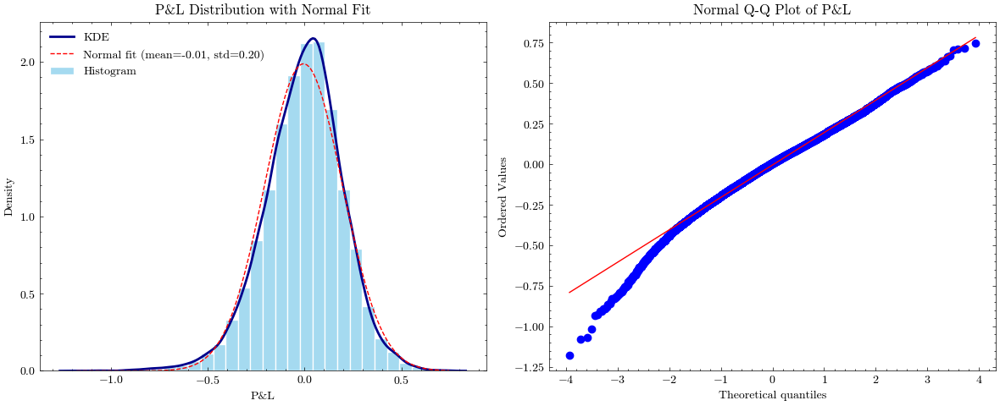

D'Agostino K² test:     stat=629.415, p=0.000
Kolmogorov-Smirnov test: stat=0.027, p=0.000


In [1]:
import myUtils; from importlib import reload; reload(myUtils)
from myUtils import delta_vswap_hedging_simulation, norm_test

results_without = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1**2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1.0,

        VEGA_HEDGE_RATIO = 0.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,               # transaction cost for variance swap as Pct of the notional

        MC_paths=1024*16,

        _plot=True, _print=False,
        seed=123456,
    )

norm_test(results_without[0])

# With a Variance Strike

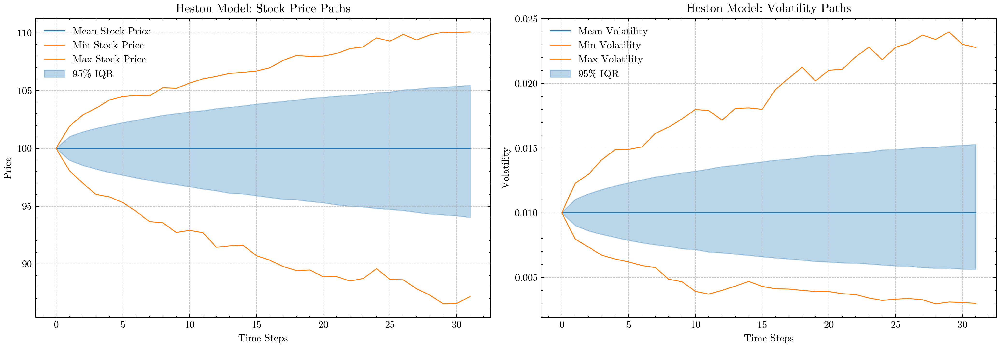

Vswap expected cost: -0.005821755653381034


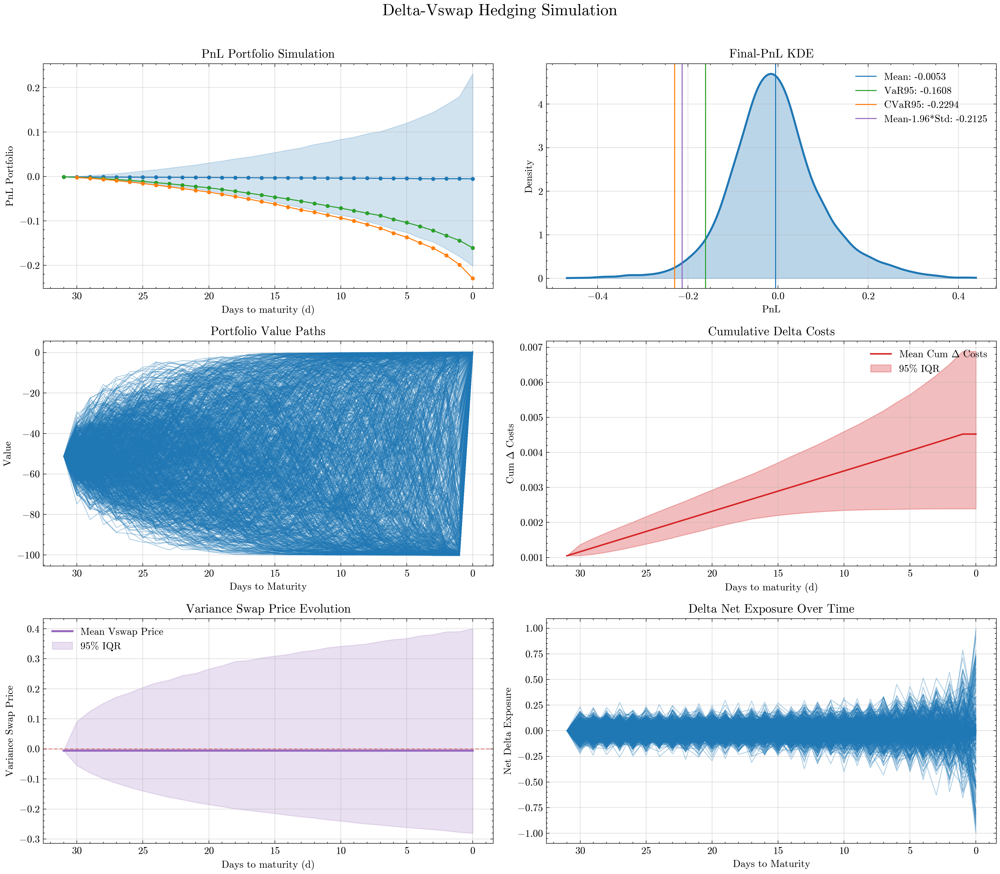

Option Price :  1.15883, Spread Earned: 0.00579
PnL mean     : -0.005288  CI [-0.00758,-0.00320]
PnL std      :  0.105709
VaR95        : -0.1608  CI [-0.1660,-0.1546]
CVaR95       : -0.2294  CI [-0.2388,-0.2209]
Mean Δ cost  :  0.004521
Vswap Notiona: 58.2176  Strike: 0.0101
Mean Swap PnL: -0.0058 CI [-0.0094,-0.0023]


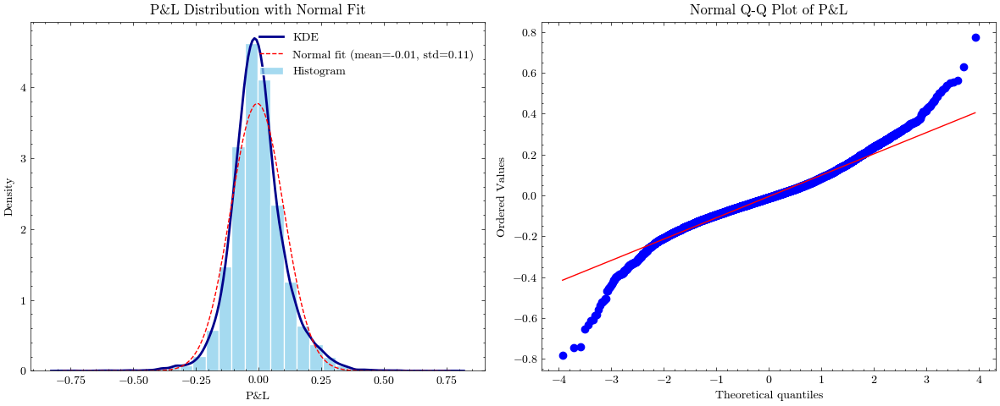

D'Agostino K² test:     stat=1160.934, p=0.000
Kolmogorov-Smirnov test: stat=0.054, p=0.000


In [47]:
import myUtils; from importlib import reload; reload(myUtils)
from myUtils import delta_vswap_hedging_simulation, norm_test

results_with = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1**2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1.0,

        VEGA_HEDGE_RATIO = 1.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,               # transaction cost for variance swap as Pct of the notional

        MC_paths=1024*16,

        _plot=True, _print=False,
        seed=123456,
    )

norm_test(results_with[0])

# Plot Difference in PnL Final

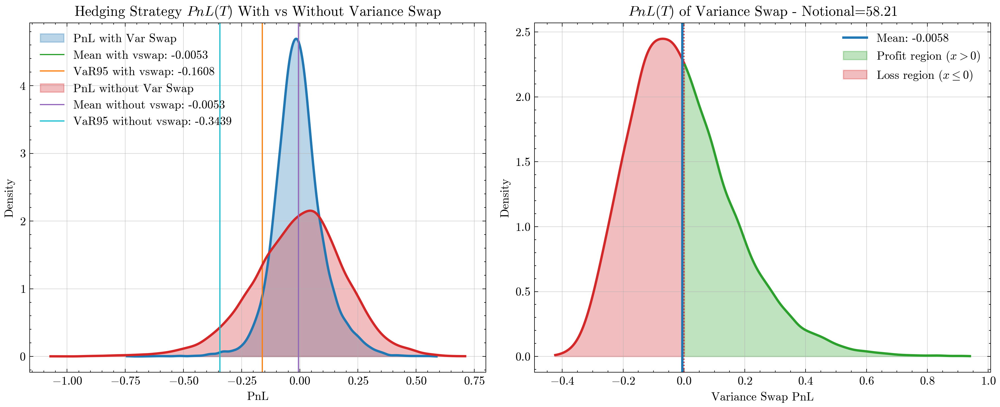

In [58]:
from scipy.stats import gaussian_kde
import numpy as np
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 2, figsize=(12, 5), dpi=300, tight_layout=True)

# First subplot: PnL with and without Variance Swap
kde = gaussian_kde(results_with[0], bw_method="scott")
x_min, x_max = np.percentile(results_with[0], [0.01, 99.99])
xg = np.linspace(x_min, x_max, 1_000)
axs[0].fill_between(xg, kde(xg), color="tab:blue", alpha=0.3, label='PnL with Var Swap')
axs[0].plot(xg, kde(xg), lw=2, color="tab:blue")
axs[0].axvline(results_with[1], color="tab:green", label=f"Mean with vswap: {results_with[1]:.4f}")
axs[0].axvline(results_with[4], color="tab:orange", label=f"VaR95 with vswap: {results_with[4]:.4f}")

kde = gaussian_kde(results_without[0], bw_method="scott")
x_min, x_max = np.percentile(results_without[0], [0.01, 99.99])
xg = np.linspace(x_min, x_max, 1_000)
axs[0].fill_between(xg, kde(xg), color="tab:red", alpha=0.3, label='PnL without Var Swap')
axs[0].plot(xg, kde(xg), lw=2, color="tab:red")
axs[0].axvline(results_without[1], color="tab:purple", label=f"Mean without vswap: {results_without[1]:.4f}")
axs[0].axvline(results_without[4], color="tab:cyan", label=f"VaR95 without vswap: {results_without[4]:.4f}")

axs[0].grid(alpha=0.5)
axs[0].legend()
axs[0].set(
    title=r"Hedging Strategy $PnL(T)$ With vs Without Variance Swap",
    xlabel=r"PnL",
    ylabel=r"Density"
)

# Second subplot: KDE of results_with[-1] with segmented line color
data = results_with[-1]
kde = gaussian_kde(data, bw_method="scott")
x_min, x_max = np.percentile(data, [0.01, 99.99])
xg = np.linspace(x_min, x_max, 1_000)
y = kde(xg)

# Define masks for profit vs. loss
mask_profit = xg > 0
mask_loss   = xg <= 0

# Plot KDE segments: profit in tab:green, loss in tab:red
axs[1].plot(xg[mask_profit], y[mask_profit],
            lw=2,
            color="tab:green")
axs[1].plot(xg[mask_loss], y[mask_loss],
            lw=2,
            color="tab:red")

# Zero line
axs[1].axvline(0, linestyle=":", color="tab:red")

# Mean line in tab:purple
mean_val = np.mean(data)
axs[1].axvline(mean_val,
               color="tab:blue",
               linestyle="-", linewidth=2,
               label=f"Mean: {mean_val:.4f}")

# Filled regions (optional)
axs[1].fill_between(xg, y,
                    where=(xg > 0),
                    color="tab:green",
                    alpha=0.3,
                    label=r"Profit region ($x>0$)")
axs[1].fill_between(xg, y,
                    where=(xg <= 0),
                    color="tab:red",
                    alpha=0.3,
                    label=r"Loss region ($x \leq 0$)")

# Final touches
axs[1].grid(alpha=0.5)
axs[1].legend()
axs[1].set(
    title=r"$PnL(T)$ of Variance Swap - Notional=$58.21$",
    xlabel="Variance Swap PnL",
    ylabel="Density"
)

plt.show()


# Over different Amounts of Vega Hedging

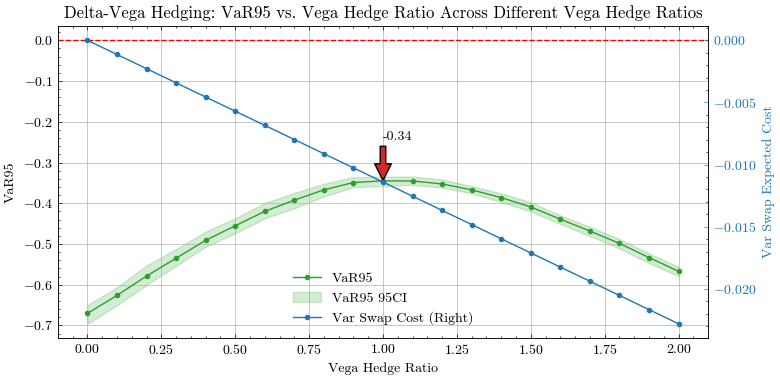

In [ ]:
import myUtils; from importlib import reload; reload(myUtils); from myUtils import *
from tqdm.notebook import tqdm

VEGA_HEDGE_RATIOs = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]
vswap_cost = [-0.0, -0.0011403253161573073, -0.0022806506323146147, -0.0034209759484719222, -0.004561301264629229, -0.005701626580786536, -0.0068419518969438445, -0.007982277213101152, -0.009122602529258459, -0.010262927845415765, -0.011403253161573071, -0.012543578477730381, -0.013683903793887689, -0.014824229110044995, -0.015964554426202305, -0.017104879742359608, -0.018245205058516917, -0.019385530374674224, -0.02052585569083153, -0.02166618100698884, -0.022806506323146142]
VaRs = [-0.6704455614089966, -0.6263086199760437, -0.5786750912666321, -0.5349896550178528, -0.4908781349658966, -0.4553278386592865, -0.4198819696903229, -0.3923474848270416, -0.3670741021633148, -0.34911254048347473, -0.34493690729141235, -0.34537580609321594, -0.3524513840675354, -0.3671364486217499, -0.386112779378891, -0.4091280996799469, -0.43911582231521606, -0.46817833185195923, -0.4986460506916046, -0.5333159565925598, -0.5670458078384399]
VaRsCI = np.array([[-0.6958996653556824, -0.64988774061203], [-0.6507267951965332, -0.6065337657928467], [-0.6005142331123352, -0.5525187849998474], [-0.5536070466041565, -0.5125431418418884], [-0.5066468119621277, -0.4693208932876587], [-0.47360759973526, -0.4367552697658539], [-0.4373560845851898, -0.3992903232574463], [-0.41223379969596863, -0.3747435510158539], [-0.3831128180027008, -0.3521452844142914], [-0.36077070236206055, -0.33569952845573425], [-0.35735711455345154, -0.3347414433956146], [-0.3549284338951111, -0.33423811197280884], [-0.36161479353904724, -0.3415735065937042], [-0.3756462335586548, -0.3580116033554077], [-0.3970792889595032, -0.37565499544143677], [-0.42021068930625916, -0.3974953591823578], [-0.45092421770095825, -0.42991334199905396], [-0.48069000244140625, -0.45780518651008606], [-0.510919988155365, -0.48785799741744995], [-0.5471144318580627, -0.52303546667099], [-0.5792954564094543, -0.5557941198348999]])

fig, ax = plt.subplots(1, 1, figsize=(8, 4), sharex=True)#, dpi=300)
ax.plot(VEGA_HEDGE_RATIOs, VaRs, marker='.', label='VaR95', color='tab:green')
ax.fill_between(VEGA_HEDGE_RATIOs, VaRsCI[:,0],  VaRsCI[:,1], color='tab:green', alpha=0.2, label='VaR95 95CI')
max_index = np.argmax(VaRs)
ax.annotate(f'{VaRs[max_index]:.2f}', xy=(VEGA_HEDGE_RATIOs[max_index], VaRs[max_index]), xytext=(VEGA_HEDGE_RATIOs[max_index], VaRs[max_index] + 0.1),
            arrowprops=dict(facecolor='tab:red', shrink=0.01))

ax.axhline(0, color='red', linestyle='--', linewidth=1)

# Create secondary axis for costs
ax2 = ax.twinx()
ax2.plot(VEGA_HEDGE_RATIOs, vswap_cost, marker='.', label='Var Swap Cost (Right)', color='tab:blue')
ax2.set_ylabel('Var Swap Expected Cost')
ax2.yaxis.label.set_color('tab:blue')      # <-- Set y-axis label color
ax2.tick_params(axis='y', colors='tab:blue')  # <-- Set tick color

ax.set_ylabel('VaR95')
ax.legend()
ax.grid()

# Combine legends from both axes
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2)
# ax2.set_ylim(-0.10, +0.001) ; ax.set_ylim(-3.5)

ax.set_title('Delta-Vega Hedging: VaR95 vs. Vega Hedge Ratio Across Different Vega Hedge Ratios')
ax.set_xlabel('Vega Hedge Ratio')
fig.tight_layout()
plt.show()

# Over different maturities

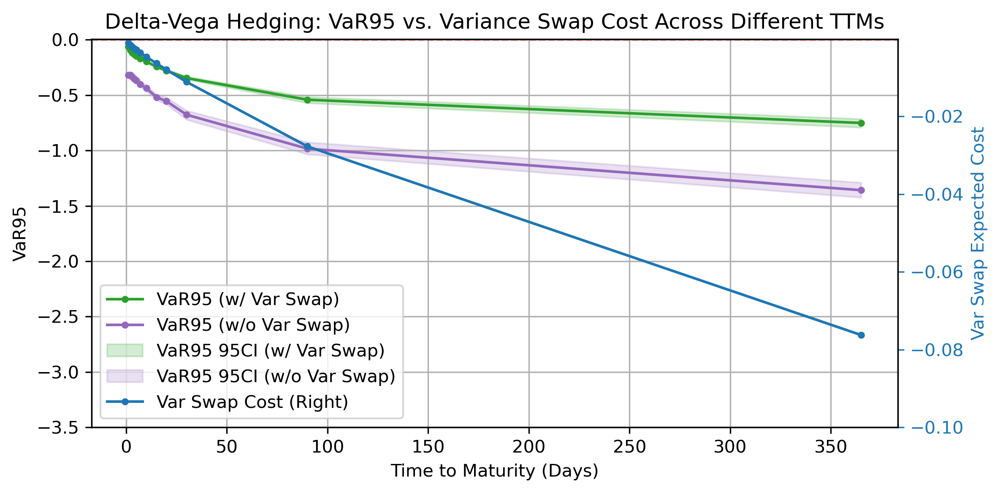

In [ ]:
# Data
ttms = [1, 2, 3, 4, 5, 7, 10, 15, 20, 30, 90, 365]

vswap_cost = [-0.0010779704209190886, -0.0015965818408722738, -0.002039258108223729, -0.002447033376585678, -0.0028345651606499532, -0.0035736030160811003, -0.004630776837857862, -0.006319047512550237, -0.00795067721167924, -0.011096066227332153, -0.02769285516715248, -0.07622851297953921]
VaRsWith = [-0.06336743384599686, -0.09492462873458862, -0.11648306250572205, -0.13083773851394653, -0.14553683996200562, -0.17020566761493683, -0.19768968224525452, -0.242470845580101, -0.279175728559494, -0.34581518173217773, -0.5416979193687439, -0.7513265609741211]
VaRsWithCI = np.array([[-0.06383150070905685, -0.06290672719478607], [-0.09700345247983932, -0.09259107708930969], [-0.12033744156360626, -0.11348205804824829], [-0.13551324605941772, -0.12727980315685272], [-0.15079450607299805, -0.13939166069030762], [-0.17518827319145203, -0.16561998426914215], [-0.20535340905189514, -0.18483567237854004], [-0.251002699136734, -0.2324504554271698], [-0.2901810109615326, -0.2669338285923004], [-0.35856324434280396, -0.33284085988998413], [-0.5709818601608276, -0.5159544348716736], [-0.7914052605628967, -0.7147369384765625]])
VaRsWithout = [-0.31887903809547424, -0.3193615674972534, -0.33344128727912903, -0.3522454798221588, -0.36848679184913635, -0.40052279829978943, -0.4375839829444885, -0.5183627605438232, -0.554490864276886, -0.6771970987319946, -0.9835230708122253, -1.3581488132476807]
VaRsWithoutCI = np.array([[-0.3298576772212982, -0.30341240763664246], [-0.3358285427093506, -0.303372323513031], [-0.34943118691444397, -0.3174265921115875], [-0.369181752204895, -0.33978015184402466], [-0.38915449380874634, -0.3517414629459381], [-0.42256566882133484, -0.375171959400177], [-0.46471351385116577, -0.41040411591529846], [-0.5441485643386841, -0.49586814641952515], [-0.5827789902687073, -0.5210763216018677], [-0.7210318446159363, -0.6398851275444031], [-1.0337094068527222, -0.9251182079315186], [-1.4240787029266357, -1.2894326448440552]])

# Create figure and primary axis
fig, ax = plt.subplots(figsize=(8, 4), dpi=300)
ax.plot(ttms, VaRsWith, marker='.', label='VaR95 (w/ Var Swap)', color='tab:green')
ax.plot(ttms, VaRsWithout, marker='.', label='VaR95 (w/o Var Swap)', color='tab:purple')
ax.fill_between(ttms, VaRsWithCI[:, 0], VaRsWithCI[:, 1], color='tab:green', alpha=0.2, label='VaR95 95CI (w/ Var Swap)')
ax.fill_between(ttms, VaRsWithoutCI[:, 0], VaRsWithoutCI[:, 1], color='tab:purple', alpha=0.2, label='VaR95 95CI (w/o Var Swap)')
ax.axhline(0, color='red', linestyle='--', linewidth=1)

# Create secondary axis for costs
ax2 = ax.twinx()
ax2.plot(ttms, vswap_cost, marker='.', label='Var Swap Cost (Right)', color='tab:blue')
ax2.set_ylabel('Var Swap Expected Cost')
ax2.yaxis.label.set_color('tab:blue')      # <-- Set y-axis label color
ax2.tick_params(axis='y', colors='tab:blue')  # <-- Set tick color

# Labels, title, grid
ax.set_xlabel('Time to Maturity (Days)')
ax.set_ylabel('VaR95')
ax.set_title('Delta-Vega Hedging: VaR95 vs. Variance Swap Cost Across Different TTMs')
ax.grid()

# Combine legends from both axes
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2)
ax2.set_ylim(-0.10, -0.0001) ; ax.set_ylim(-3.5)

# Layout and show
fig.tight_layout()
plt.show()

# Over different Volatilities

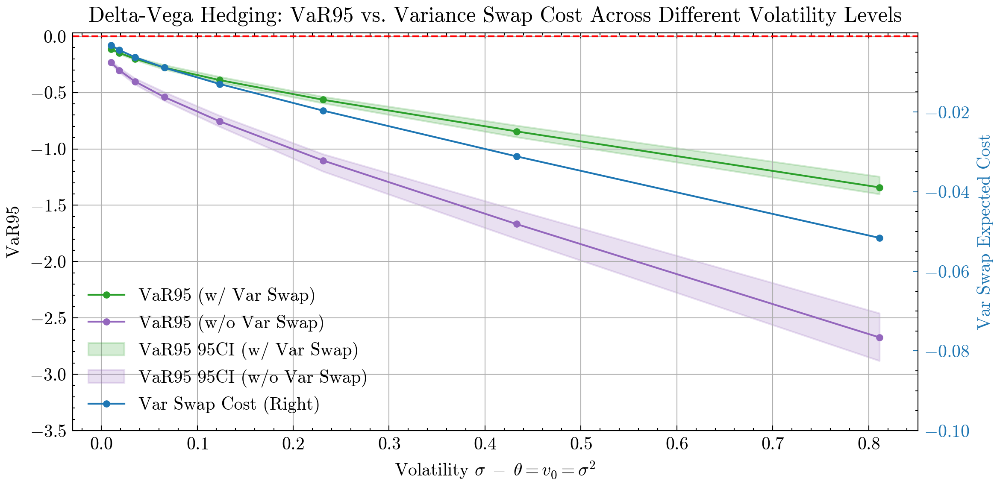

In [ ]:
# Data
vols = [0.01, 0.01873817422860384, 0.03511191734215131, 0.0657933224657568, 0.12328467394420659, 0.23101297000831592, 0.4328761281083057, 0.8111308307896868]
vswap_cost = [-0.0032164090405930735, -0.004465485990028539, -0.00625255226919523, -0.00889402475636231, -0.012981194156186895, -0.019660719100462427, -0.031154647515996538, -0.051611187682530445]
VaRsWith = [-0.1134425550699234, -0.14835786819458008, -0.20032145082950592, -0.2782106399536133, -0.3892936110496521, -0.5636194944381714, -0.8446042537689209, -1.3413059711456299]
VaRsWithCI = np.array([[-0.11968071013689041, -0.10723067820072174], [-0.1572844386100769, -0.1373073309659958], [-0.21050409972667694, -0.18587897717952728], [-0.2947060763835907, -0.25607025623321533], [-0.410138338804245, -0.3596208989620209], [-0.5937353372573853, -0.5364642143249512], [-0.8951072096824646, -0.7920501232147217], [-1.4005740880966187, -1.245481014251709]])
VaRsWithout = [-0.23303788900375366, -0.30252885818481445, -0.40177783370018005, -0.540643572807312, -0.7551755905151367, -1.1027947664260864, -1.6670786142349243, -2.6726160049438477]
VaRsWithoutCI = np.array([[-0.24529428780078888, -0.21791201829910278], [-0.3191239535808563, -0.2803495228290558], [-0.42642512917518616, -0.37460780143737793], [-0.5724049806594849, -0.4964163303375244], [-0.8021764755249023, -0.7043704390525818], [-1.1993978023529053, -1.0459694862365723], [-1.7982829809188843, -1.5427993535995483], [-2.880005359649658, -2.4580280780792236]])


# Create figure and primary axis
fig, ax = plt.subplots(figsize=(8, 4), dpi=300)
ax.plot(vols, VaRsWith, marker='.', label='VaR95 (w/ Var Swap)', color='tab:green')
ax.plot(vols, VaRsWithout, marker='.', label='VaR95 (w/o Var Swap)', color='tab:purple')
ax.fill_between(vols, VaRsWithCI[:, 0], VaRsWithCI[:, 1], color='tab:green', alpha=0.2, label='VaR95 95CI (w/ Var Swap)')
ax.fill_between(vols, VaRsWithoutCI[:, 0], VaRsWithoutCI[:, 1], color='tab:purple', alpha=0.2, label='VaR95 95CI (w/o Var Swap)')
ax.axhline(0, color='red', linestyle='--', linewidth=1)

# Create secondary axis for costs
ax2 = ax.twinx()
ax2.plot(vols, vswap_cost, marker='.', label='Var Swap Cost (Right)', color='tab:blue')
ax2.set_ylabel('Var Swap Expected Cost')
ax2.yaxis.label.set_color('tab:blue')      # <-- Set y-axis label color
ax2.tick_params(axis='y', colors='tab:blue')  # <-- Set tick color

# Labels, title, grid
ax.set_xlabel(r'Volatility $\sigma \; - \; \theta=v_0=\sigma^2$')
ax.set_ylabel('VaR95')
ax.set_title('Delta-Vega Hedging: VaR95 vs. Variance Swap Cost Across Different Volatility Levels')
ax.grid()

# Combine legends from both axes
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2)
ax2.set_ylim(-0.10, -0.0001) ; ax.set_ylim(-3.5)
# Layout and show
fig.tight_layout()
plt.show()

# Over different volvol values

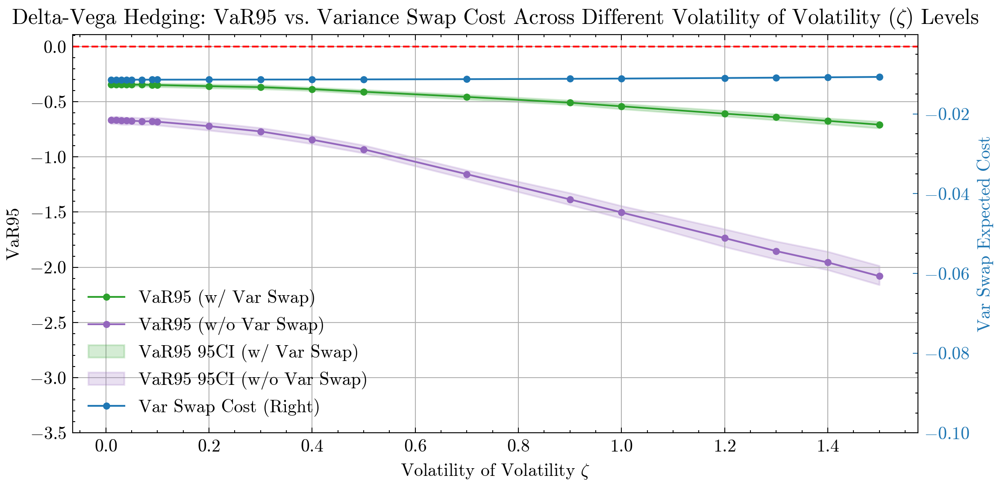

In [ ]:
# Data
volvols = [0.01, 0.02, 0.03, 0.04, 0.05, 0.07, 0.09, 0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9, 1.0, 1.2, 1.3, 1.4, 1.5]

vswap_cost = [-0.011413105755393891, -0.011412074517446705, -0.011411027686507268, -0.01140996518772667, -0.011408886916132717, -0.011406682483190522, -0.011404412937676769, -0.011403253161573071, -0.011390655478513534, -0.011375873332704916, -0.011358153637299988, -0.011336474829618344, -0.011276327608117052, -0.011186089060284536, -0.011127828973440232, -0.01098489964191456, -0.010901293706669004, -0.01081070480648393, -0.010714116138702696]
VaRsWith = [-0.34475845098495483, -0.34469467401504517, -0.34572628140449524, -0.3454030454158783, -0.34530729055404663, -0.34561997652053833, -0.34767255187034607, -0.3489178717136383, -0.3591419756412506, -0.3680983781814575, -0.38572588562965393, -0.4101903438568115, -0.45669060945510864, -0.5088216662406921, -0.5416116714477539, -0.6081832647323608, -0.6394773721694946, -0.6734154224395752, -0.7076303362846375]
VaRsWithCI = np.array([[-0.36078500747680664, -0.32945480942726135], [-0.3592860996723175, -0.3292318880558014], [-0.36125439405441284, -0.331339955329895], [-0.3616733253002167, -0.33262068033218384], [-0.360246866941452, -0.3322790265083313], [-0.35909995436668396, -0.3313120901584625], [-0.3645612597465515, -0.3336442708969116], [-0.3656821548938751, -0.33402177691459656], [-0.3766244947910309, -0.3424384295940399], [-0.38422417640686035, -0.3489318788051605], [-0.4007633328437805, -0.3711840808391571], [-0.42866387963294983, -0.39274513721466064], [-0.47782209515571594, -0.4373166859149933], [-0.5270698070526123, -0.48810428380966187], [-0.5659570693969727, -0.5197139978408813], [-0.6313825249671936, -0.581230103969574], [-0.6663104295730591, -0.613390326499939], [-0.7032797336578369, -0.6507461667060852], [-0.7396056056022644, -0.6799790263175964]])
VaRsWithout = [-0.665883481502533, -0.6673088073730469, -0.6687101721763611, -0.6713866591453552, -0.6719408631324768, -0.6775057911872864, -0.6778066754341125, -0.6813561320304871, -0.7215015888214111, -0.7689871788024902, -0.8441932797431946, -0.931274950504303, -1.1564559936523438, -1.3847885131835938, -1.5032392740249634, -1.735424518585205, -1.8532291650772095, -1.95579195022583, -2.080329418182373]
VaRsWithoutCI = np.array([[-0.7001202702522278, -0.6372971534729004], [-0.6992278099060059, -0.6361861228942871], [-0.706377387046814, -0.6382289528846741], [-0.7082290053367615, -0.6440730690956116], [-0.7042347192764282, -0.6418384313583374], [-0.7107839584350586, -0.6481414437294006], [-0.7082381844520569, -0.6422111988067627], [-0.712886393070221, -0.6448874473571777], [-0.7595844268798828, -0.6876991391181946], [-0.8098520040512085, -0.7371450662612915], [-0.8822534084320068, -0.8073927760124207], [-0.9659134745597839, -0.8946483135223389], [-1.1992199420928955, -1.1203831434249878], [-1.4347734451293945, -1.3268505334854126], [-1.5560424327850342, -1.4436103105545044], [-1.815056324005127, -1.6541974544525146], [-1.928303599357605, -1.7645387649536133], [-2.0238754749298096, -1.857635259628296], [-2.158813953399658, -1.986281394958496]])

# Create figure and primary axis
fig, ax = plt.subplots(figsize=(8, 4), dpi=300)
ax.plot(volvols, VaRsWith, marker='.', label='VaR95 (w/ Var Swap)', color='tab:green')
ax.plot(volvols, VaRsWithout, marker='.', label='VaR95 (w/o Var Swap)', color='tab:purple')
ax.fill_between(volvols, VaRsWithCI[:, 0], VaRsWithCI[:, 1], color='tab:green', alpha=0.2, label='VaR95 95CI (w/ Var Swap)')
ax.fill_between(volvols, VaRsWithoutCI[:, 0], VaRsWithoutCI[:, 1], color='tab:purple', alpha=0.2, label='VaR95 95CI (w/o Var Swap)')
ax.axhline(0, color='red', linestyle='--', linewidth=1)

# Create secondary axis for costs
ax2 = ax.twinx()
ax2.plot(volvols, vswap_cost, marker='.', label='Var Swap Cost (Right)', color='tab:blue')
ax2.set_ylabel('Var Swap Expected Cost')
ax2.yaxis.label.set_color('tab:blue')      # <-- Set y-axis label color
ax2.tick_params(axis='y', colors='tab:blue')  # <-- Set tick color

# Labels, title, grid
ax.set_xlabel(r'Volatility of Volatility $\zeta$')
ax.set_ylabel('VaR95')
ax.set_title(r'Delta-Vega Hedging: VaR95 vs. Variance Swap Cost Across Different Volatility of Volatility ($\zeta$) Levels')
ax.grid()

# Combine legends from both axes
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2)
ax2.set_ylim(-0.10, -0.0001) ; ax.set_ylim(-3.5)

# Layout and show
fig.tight_layout()
plt.show()

# Over different amounts of Hedging steps

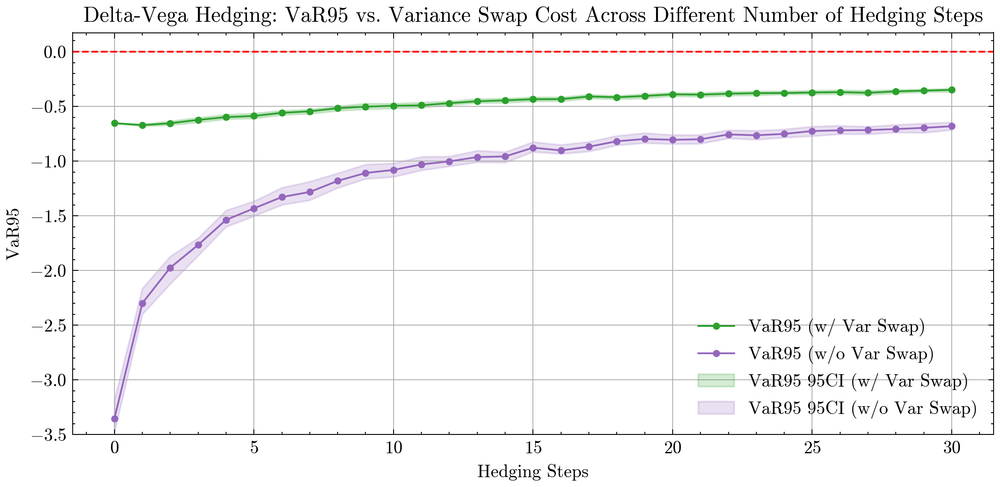

In [ ]:
# Data
hedging_steps_list = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30]
vswap_cost = [0.03451369525078083, 5.65954201401915e-05, -0.006335244788375426, -0.008573195349077856, -0.009609188406302224, -0.010171987648037277, -0.01051135062753769, -0.010731615402161594, -0.010882630548355815, -0.010990651962832405, -0.011070576220531673, -0.011131365530414812, -0.011178674121272592, -0.011216212172934588, -0.011246496043274856, -0.011271281229083965, -0.0112918226235522, -0.011309036539071744, -0.011323604694430531, -0.011336042763256653, -0.011346746643406317, -0.011356024354177088, -0.011364118445838099, -0.011371222015089305, -0.011377490328999658, -0.011383049382261982, -0.011388002278258463, -0.011392434044363442, -0.01139641530566801, -0.011400005116198621, -0.011403253161573071]
VaRsWith = [-0.653333306312561, -0.671264111995697, -0.6541402339935303, -0.6236828565597534, -0.5980620980262756, -0.5875847339630127, -0.5589146614074707, -0.5453334450721741, -0.5168027877807617, -0.5024706125259399, -0.49430105090141296, -0.4899495244026184, -0.4705357253551483, -0.45311981439590454, -0.44520390033721924, -0.4346529245376587, -0.4336642026901245, -0.40949946641921997, -0.41637998819351196, -0.40503308176994324, -0.38975343108177185, -0.3926073908805847, -0.3841036260128021, -0.37900230288505554, -0.37793076038360596, -0.3730325996875763, -0.3696036636829376, -0.37593773007392883, -0.36282414197921753, -0.3557087779045105, -0.3489178717136383]
VaRsWithCI = np.array([[-0.6545308828353882, -0.6525104641914368], [-0.6810766458511353, -0.6621494889259338], [-0.6704346537590027, -0.6346638202667236], [-0.6464497447013855, -0.6023798584938049], [-0.6154754757881165, -0.575918436050415], [-0.609473466873169, -0.563348114490509], [-0.5770877003669739, -0.5381327271461487], [-0.5667896866798401, -0.5268762707710266], [-0.539094090461731, -0.4983924627304077], [-0.524581789970398, -0.4738391041755676], [-0.5168240070343018, -0.4736941456794739], [-0.5105792284011841, -0.46355241537094116], [-0.48674485087394714, -0.4528607130050659], [-0.4681779146194458, -0.43092188239097595], [-0.4652022123336792, -0.427154004573822], [-0.45278239250183105, -0.41515353322029114], [-0.4513717293739319, -0.41553881764411926], [-0.42737552523612976, -0.39162886142730713], [-0.4335349202156067, -0.40208059549331665], [-0.42574355006217957, -0.38593238592147827], [-0.40584298968315125, -0.3748902976512909], [-0.4117756485939026, -0.3752787411212921], [-0.4005014896392822, -0.3653969168663025], [-0.39810094237327576, -0.3612174093723297], [-0.38966473937034607, -0.3606289029121399], [-0.38925978541374207, -0.3546222448348999], [-0.38796231150627136, -0.3506949245929718], [-0.39302605390548706, -0.3559497892856598], [-0.3805783987045288, -0.3481229543685913], [-0.3688914179801941, -0.3431348204612732], [-0.3664516806602478, -0.33501002192497253]])
VaRsWithout = [-3.3539857864379883, -2.2990221977233887, -1.9746118783950806, -1.7662489414215088, -1.5373882055282593, -1.4321396350860596, -1.3285508155822754, -1.2822675704956055, -1.1809980869293213, -1.1083958148956299, -1.0807217359542847, -1.030030608177185, -1.0026612281799316, -0.9633633494377136, -0.9574453234672546, -0.8774692416191101, -0.9024125933647156, -0.8683954477310181, -0.8188194036483765, -0.7975484132766724, -0.8055105209350586, -0.8003356456756592, -0.756378710269928, -0.7638750672340393, -0.7513453960418701, -0.7252401113510132, -0.718619167804718, -0.7165026664733887, -0.7070722579956055, -0.6961581707000732, -0.6813561320304871]
VaRsWithoutCI = np.array([[-3.476466178894043, -3.182934045791626], [-2.3996098041534424, -2.163853168487549], [-2.1221704483032227, -1.8695027828216553], [-1.8635202646255493, -1.7034984827041626], [-1.6002733707427979, -1.4503974914550781], [-1.502267837524414, -1.3660916090011597], [-1.399932622909546, -1.2426413297653198], [-1.356826901435852, -1.186708927154541], [-1.2443214654922485, -1.110315203666687], [-1.1616268157958984, -1.0302914381027222], [-1.1437147855758667, -1.0191597938537598], [-1.0838773250579834, -0.9594309329986572], [-1.0469595193862915, -0.9570611715316772], [-1.0099321603775024, -0.9039856195449829], [-1.0123369693756104, -0.9165070056915283], [-0.9145533442497253, -0.8246772885322571], [-0.9339485168457031, -0.8509541153907776], [-0.9108315706253052, -0.8233047723770142], [-0.8551220893859863, -0.7686077356338501], [-0.8339217305183411, -0.7434152960777283], [-0.8431447744369507, -0.760270893573761], [-0.8403770923614502, -0.7589609622955322], [-0.7913610339164734, -0.7165326476097107], [-0.8034225702285767, -0.7213932871818542], [-0.7840201258659363, -0.7087815403938293], [-0.7709794640541077, -0.6831604242324829], [-0.7527265548706055, -0.6755656599998474], [-0.7533255219459534, -0.6846103668212891], [-0.737156867980957, -0.6675176620483398], [-0.7403832077980042, -0.6550079584121704], [-0.7141948342323303, -0.6454029679298401]])

fig, ax = plt.subplots(figsize=(8, 4), dpi=300)
ax.plot(hedging_steps_list, VaRsWith, marker='.', label='VaR95 (w/ Var Swap)', color='tab:green')
ax.plot(hedging_steps_list, VaRsWithout, marker='.', label='VaR95 (w/o Var Swap)', color='tab:purple')
ax.fill_between(hedging_steps_list, VaRsWithCI[:, 0], VaRsWithCI[:, 1], color='tab:green', alpha=0.2, label='VaR95 95CI (w/ Var Swap)')
ax.fill_between(hedging_steps_list, VaRsWithoutCI[:, 0], VaRsWithoutCI[:, 1], color='tab:purple', alpha=0.2, label='VaR95 95CI (w/o Var Swap)')
ax.axhline(0, color='red', linestyle='--', linewidth=1)

ax.set_xlabel('Hedging Steps')
ax.set_ylabel('VaR95')
ax.set_title('Delta-Vega Hedging: VaR95 vs. Variance Swap Cost Across Different Number of Hedging Steps')
ax.grid()

# Combine legends from both axes
lines, labels = ax.get_legend_handles_labels()
ax.legend(lines, labels, loc='best')
ax.set_ylim(-3.5)

fig.tight_layout()
plt.show()

---
# Earnings Gap

## Without Variance Swap

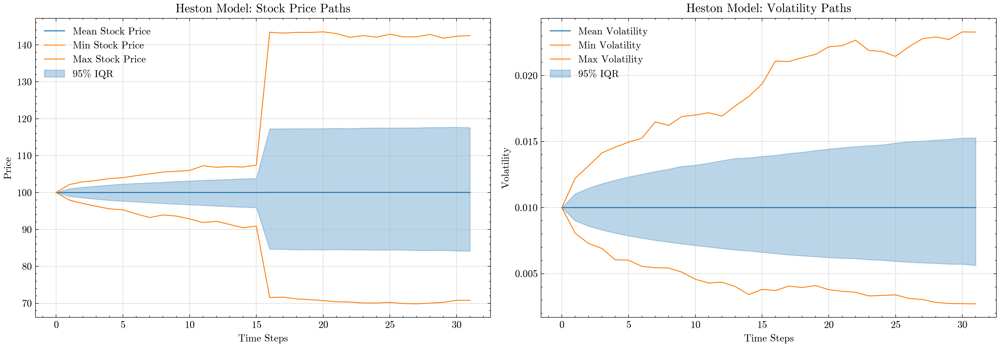

Vswap expected cost: -0.0


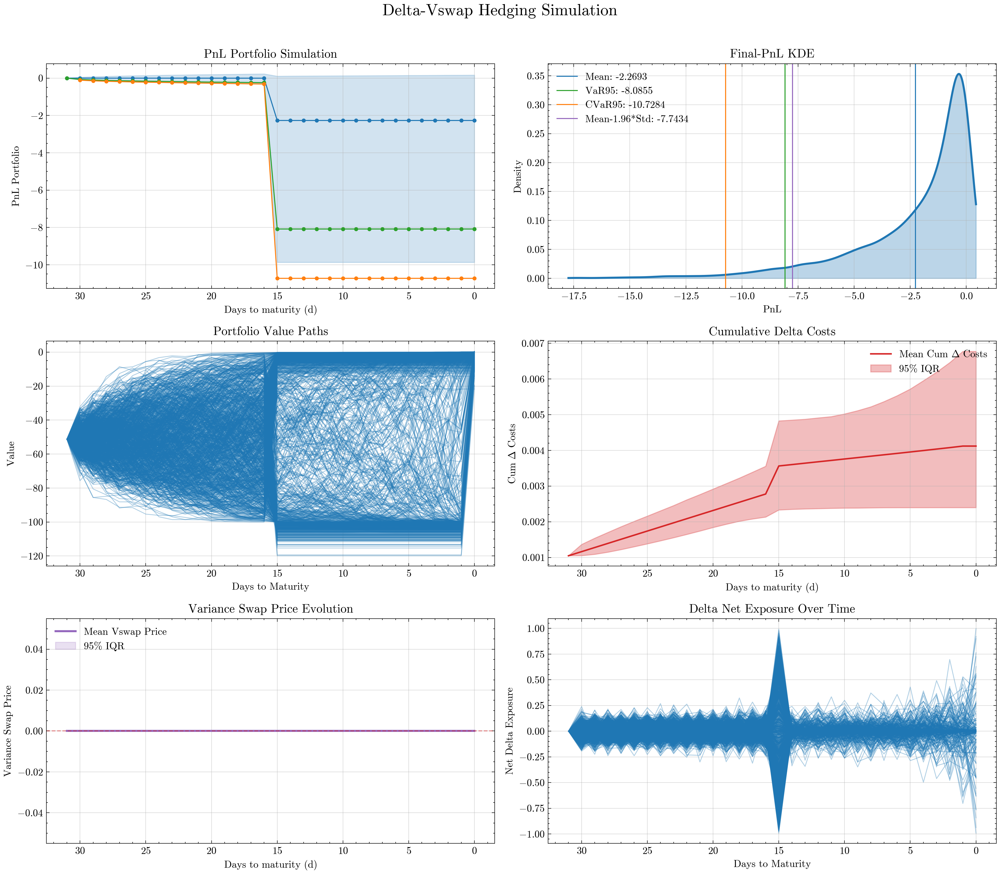

Option Price :  1.15883, Spread Earned: 0.00579
PnL mean     : -2.269341  CI [-2.33162,-2.21223]
PnL std      :  2.792880
VaR95        : -8.0855  CI [-8.3779,-7.8468]
CVaR95       : -10.7284  CI [-11.0474,-10.3998]
Mean Δ cost  :  0.004120
Vswap Notiona: 0.0000  Strike: 0.0101
Mean Swap PnL: 0.0000 CI [0.0000,0.0000]


In [41]:
import myUtils; from importlib import reload; reload(myUtils); from myUtils import *

results = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1**2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1.0,

        VEGA_HEDGE_RATIO = 0.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,                   # transaction cost for variance swap as Pct of the notional

        shock_step=16, # 16
        sigma_eps=0.08,

        MC_paths=1024*16,

        _plot=True, _print=False,
    )

# norm_test(results[0])

## With Variance Swap

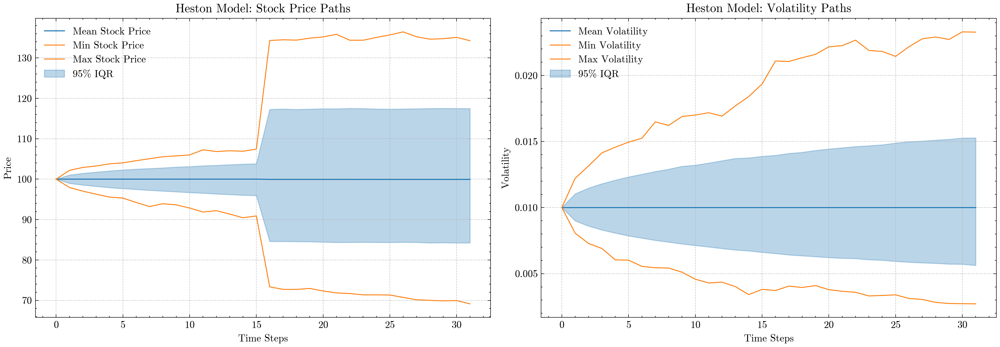

Vswap expected cost: -0.005821755653381034


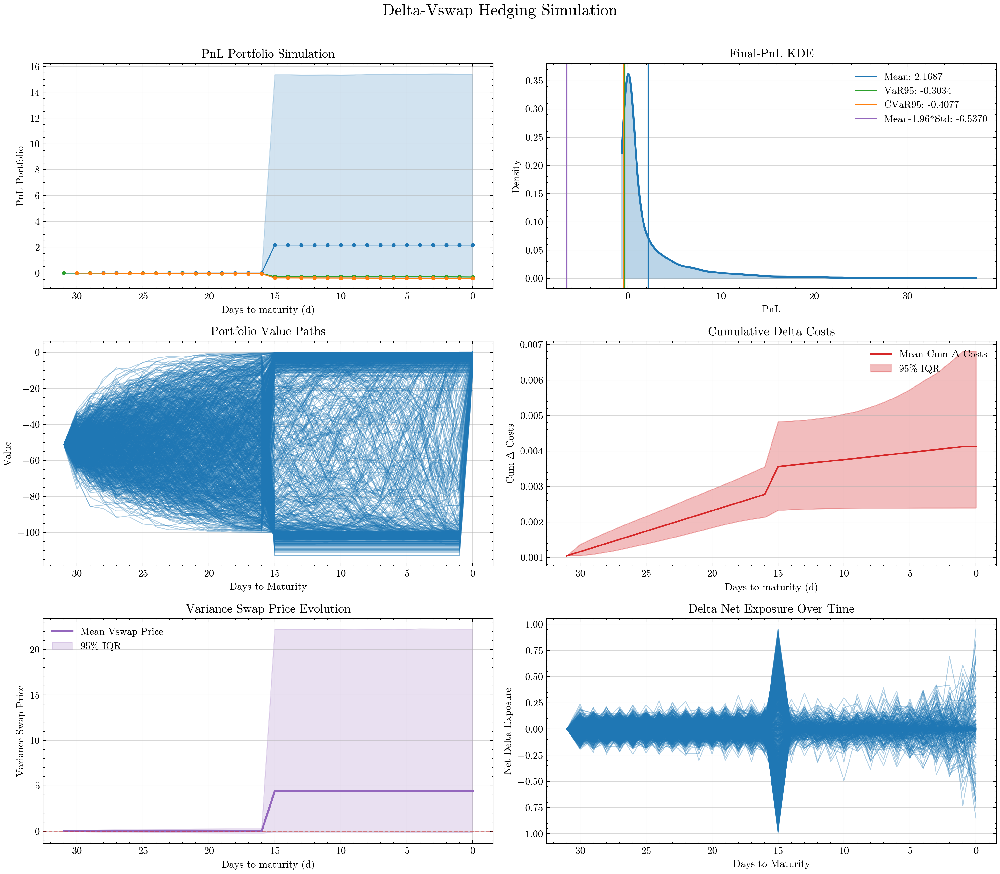

Option Price :  1.15883, Spread Earned: 0.00579
PnL mean     : 2.168670  CI [2.07997,2.24970]
PnL std      :  4.441689
VaR95        : -0.3034  CI [-0.3138,-0.2904]
CVaR95       : -0.4077  CI [-0.4206,-0.3953]
Mean Δ cost  :  0.004124
Vswap Notiona: 58.2176  Strike: 0.0101
Mean Swap PnL: 4.4224 CI [4.2971,4.5441]


In [40]:
import myUtils; from importlib import reload; reload(myUtils); from myUtils import *

results = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1**2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1.0,

        VEGA_HEDGE_RATIO = 1.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,                   # transaction cost for variance swap as Pct of the notional

        shock_step=16, # 16
        sigma_eps=0.08,

        MC_paths=1024*16,

        _plot=True, _print=False,
    )

# norm_test(results[0])

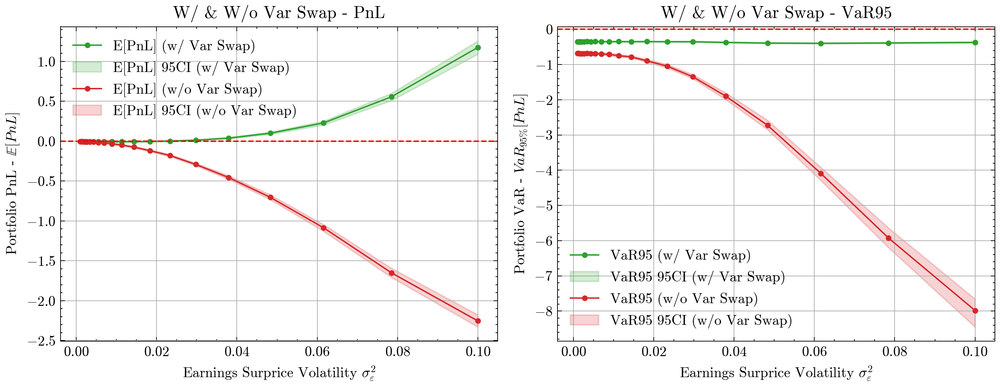

In [39]:
sigma_epss = np.array([0.001, 0.00127427, 0.00162378, 0.00206914, 0.00263665, 0.00335982, 0.00428133, 0.00545559, 0.00695193, 0.00885867, 0.01128838, 0.0143845, 0.01832981, 0.02335721, 0.02976351, 0.0379269, 0.0483293, 0.06158482, 0.078476, 0.1])

pnl_meanWith = np.array([-0.00532501, -0.00547601, -0.00499771, -0.00493083, -0.00509838, -0.00552631, -0.00558741, -0.00425527, -0.00480841, -0.00683223, -0.00530306, -0.00578677, -0.00273599, 0.00146706, 0.012131, 0.03841216, 0.1005061, 0.2288143, 0.55582947, 1.17492795])
pnl_meanWithCI = np.array([[-0.01222046, 0.00134529], [-0.01208327, 0.00145609], [-0.01203472, 0.00146937], [-0.01198748, 0.00229262], [-0.01235817, 0.00199187], [-0.01206956, 0.0011746], [-0.01297409, 0.00113471], [-0.01116191, 0.00251882], [-0.01156417, 0.00251105], [-0.01400063, 0.00015815], [-0.01187213, 0.00181495], [-0.01283314, 0.00105011], [-0.00984832, 0.00459107], [-0.00573685, 0.00901344], [0.00381339, 0.02025045], [0.02844257, 0.04858797], [0.08636892, 0.11508334], [0.20360216, 0.25131345], [0.50888091, 0.59873843], [1.09012032, 1.25629485]])
VaR95With = np.array([-0.34933624, -0.34966964, -0.34763145, -0.34745121, -0.34823626, -0.34611097, -0.34826952, -0.34561613, -0.35048354, -0.35060534, -0.34665525, -0.35008138, -0.34701827, -0.35052621, -0.35212392, -0.37108102, -0.38976511, -0.39691991, -0.38643891, -0.3707411])
VaR95WithCI = np.array([[-0.36485666, -0.33521199], [-0.36651817, -0.33581752], [-0.36191562, -0.33147654], [-0.36250609, -0.3309333], [-0.3621259, -0.33302951], [-0.36084363, -0.32904291], [-0.36163554, -0.33013934], [-0.35877907, -0.33122754], [-0.36501423, -0.33410022], [-0.36613226, -0.33940414], [-0.35924017, -0.33476132], [-0.36581203, -0.33352384], [-0.36015919, -0.33398792], [-0.36494574, -0.33747956], [-0.36319953, -0.33430615], [-0.38578081, -0.35447264], [-0.40434891, -0.37462646], [-0.40966767, -0.37742862], [-0.40355286, -0.36736798], [-0.38782686, -0.35509899]])
pnl_meanWithOut = np.array([-0.00541666, -0.00649856, -0.0063861, -0.00712111, -0.00803843, -0.00994796, -0.01081718, -0.0163485, -0.02071822, -0.03253905, -0.04878551, -0.07477082, -0.11855775, -0.18007091, -0.29141825, -0.4554711, -0.7040298, -1.085361, -1.6497618, -2.25270224])
pnl_meanWithOutCI = np.array([[-0.01677225, 0.00525666], [-0.01803927, 0.00501654], [-0.01821311, 0.00481346], [-0.01884574, 0.00452748], [-0.0197738, 0.00364844], [-0.02104873, 0.00152723], [-0.02198103, 0.00104653], [-0.02758298, -0.00474496], [-0.03257226, -0.00916733], [-0.04333823, -0.02145959], [-0.06043482, -0.03691426], [-0.0867274, -0.06317893], [-0.13084841, -0.10630549], [-0.19374038, -0.16596867], [-0.3076643, -0.27557299], [-0.47707698, -0.43254313], [-0.73284709, -0.67312306], [-1.1285857, -1.04577839], [-1.70663178, -1.59188104], [-2.32904577, -2.1760571]])
VaR95WithOut = np.array([-0.68413937, -0.67968726, -0.68735427, -0.68528038, -0.68685961, -0.68356061, -0.68533754, -0.68627405, -0.70367044, -0.70761806, -0.74874651, -0.78330761, -0.89398676, -1.04577219, -1.34823549, -1.8972919, -2.72519445, -4.08756304, -5.92659855, -7.9815588])
VaR95WithOutCI = np.array([[-0.71330196, -0.64242399], [-0.70822269, -0.64233404], [-0.72571385, -0.65413529], [-0.71839082, -0.64949423], [-0.72011101, -0.65294886], [-0.71827775, -0.64343566], [-0.71984959, -0.65621114], [-0.71725196, -0.64208877], [-0.73517376, -0.66459405], [-0.74194777, -0.66582561], [-0.7838065, -0.71185464], [-0.81092, -0.74338168], [-0.93465936, -0.85260218], [-1.09671879, -0.99473608], [-1.40129232, -1.28633308], [-1.99399781, -1.80235291], [-2.84681606, -2.58013535], [-4.28853798, -3.91467381], [-6.20092964, -5.64047146], [-8.45033073, -7.65617657]])
# Create figure and primary axis
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10, 4), dpi=300)

ax1.plot(sigma_epss, pnl_meanWith, marker='.', label='E[PnL] (w/ Var Swap)', color='tab:green')
ax1.fill_between(sigma_epss, pnl_meanWithCI[:, 0], pnl_meanWithCI[:, 1], color='tab:green', alpha=0.2, label='E[PnL] 95CI (w/ Var Swap)')
ax1.plot(sigma_epss, pnl_meanWithOut, marker='.', label='E[PnL] (w/o Var Swap)', color='tab:red')
ax1.fill_between(sigma_epss, pnl_meanWithOutCI[:, 0], pnl_meanWithOutCI[:, 1], color='tab:red', alpha=0.2, label='E[PnL] 95CI (w/o Var Swap)')
ax1.axhline(0, color='red', linestyle='--', linewidth=1)
ax1.grid() ; ax1.legend()
ax1.set_xlabel(r'Earnings Surprice Volatility $\sigma_{\varepsilon}^2$') ; ax1.set_ylabel(r'Portfolio PnL - $\mathbb{E}[PnL]$')
ax1.set_title('W/ & W/o Var Swap - PnL')

ax2.plot(sigma_epss, VaR95With, marker='.', label='VaR95 (w/ Var Swap)', color='tab:green')
ax2.fill_between(sigma_epss, VaR95WithCI[:, 0], VaR95WithCI[:, 1], color='tab:green', alpha=0.2, label='VaR95 95CI (w/ Var Swap)')
ax2.plot(sigma_epss, VaR95WithOut, marker='.', label='VaR95 (w/o Var Swap)', color='tab:red')
ax2.fill_between(sigma_epss, VaR95WithOutCI[:, 0], VaR95WithOutCI[:, 1], color='tab:red', alpha=0.2, label='VaR95 95CI (w/o Var Swap)')
ax2.axhline(0, color='red', linestyle='--', linewidth=1)
ax2.grid() ; ax2.legend()
ax2.set_xlabel(r'Earnings Surprice Volatility $\sigma_{\varepsilon}^2$') ; ax2.set_ylabel(r'Portfolio VaR - $VaR_{95\%}[PnL]$')
ax2.set_title('W/ & W/o Var Swap - VaR95')

# Layout and show
fig.tight_layout()
plt.show()

In [ ]:
import myUtils; from importlib import reload; reload(myUtils); from myUtils import *
from tqdm.notebook import tqdm

sigma_epss = np.logspace(np.log10(0.001), np.log10(0.1), 20, dtype=float)

for sigma_eps in tqdm(sigma_epss):
    print(f'-- {sigma_eps=} ------------------------')
    final_pnl, pnl_mean, μ_ci, pnl_std, VaR95, VaR_ci, CVaR95, CVaR_ci, cum_total, Vswap_value = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1*2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1,

        VEGA_HEDGE_RATIO = 0.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,               # transaction cost for variance swap as Pct of the notional

        shock_step=16, # 16
        sigma_eps=sigma_eps, 

        MC_paths=1024*8,

        _plot=False, _print=False, seed=12345
    )
    print(f'W/o : pnl_mean={float(pnl_mean)} - VaR_ci=({float(μ_ci[0])},{float(μ_ci[1])})')
    print(f'W/o : VaR95={float(VaR95)} - VaR_ci=({float(VaR_ci[0])},{float(VaR_ci[1])})')
    final_pnl, pnl_mean, μ_ci, pnl_std, VaR95, VaR_ci, CVaR95, CVaR_ci, cum_total, Vswap_value = delta_vswap_hedging_simulation(
        S0=100, K=100, ttm=31, hedging_steps=30,
        r=0.00, q=0.0, v0=0.1**2, theta=0.1*2, kappa=4.0,
        volvol=0.1, rho=-0.7,

        Underlying_SPREAD=0.00002, Option_SPREAD=0.005,
        DELTA_HEDGE_PERCT=1,

        VEGA_HEDGE_RATIO = 1.,            # % of Vega exposure to offset
        Vswap_TC = 0.01,               # transaction cost for variance swap as Pct of the notional

        shock_step=16, # 16
        sigma_eps=sigma_eps, 

        MC_paths=1024*8,

        _plot=False, _print=False, seed=12345
    )
    print(f'W/ : pnl_mean={float(pnl_mean)} - VaR_ci=({float(μ_ci[0])},{float(μ_ci[1])})')
    print(f'W/: VaR95={float(VaR95)} - VaR_ci=({float(VaR_ci[0])},{float(VaR_ci[1])})')
    print()


  0%|          | 0/20 [00:00<?, ?it/s]

-- sigma_eps=np.float64(0.001) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.005416661500930786 - VaR_ci=(-0.016772251576185226,0.005256658419966698)
W/o : VaR95=-0.6841393709182739 - VaR_ci=(-0.713301956653595,-0.6424239873886108)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005325010046362877 - VaR_ci=(-0.012220460921525955,0.0013452926650643349)
W/: VaR95=-0.3493362367153168 - VaR_ci=(-0.36485666036605835,-0.33521199226379395)

-- sigma_eps=np.float64(0.0012742749857031334) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.006498563103377819 - VaR_ci=(-0.018039271235466003,0.005016544833779335)
W/o : VaR95=-0.6796872615814209 - VaR_ci=(-0.7082226872444153,-0.6423340439796448)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.0054760100319981575 - VaR_ci=(-0.0120832659304142,0.0014560893177986145)
W/: VaR95=-0.3496696352958679 - VaR_ci=(-0.36651816964149475,-0.33581751585006714)

-- sigma_eps=np.float64(0.001623776739188721) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.006386100314557552 - VaR_ci=(-0.01821310818195343,0.004813455045223236)
W/o : VaR95=-0.6873542666435242 - VaR_ci=(-0.725713849067688,-0.6541352868080139)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.004997706040740013 - VaR_ci=(-0.012034716084599495,0.0014693746343255043)
W/: VaR95=-0.34763145446777344 - VaR_ci=(-0.36191561818122864,-0.3314765393733978)

-- sigma_eps=np.float64(0.00206913808111479) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.007121107075363398 - VaR_ci=(-0.01884574070572853,0.004527484066784382)
W/o : VaR95=-0.6852803826332092 - VaR_ci=(-0.7183908224105835,-0.6494942307472229)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.0049308305606245995 - VaR_ci=(-0.011987479403614998,0.0022926218807697296)
W/: VaR95=-0.34745121002197266 - VaR_ci=(-0.36250609159469604,-0.3309333026409149)

-- sigma_eps=np.float64(0.0026366508987303583) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.00803842581808567 - VaR_ci=(-0.019773798063397408,0.003648439422249794)
W/o : VaR95=-0.6868596076965332 - VaR_ci=(-0.7201110124588013,-0.6529488563537598)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005098377354443073 - VaR_ci=(-0.012358169071376324,0.0019918708130717278)
W/: VaR95=-0.3482362627983093 - VaR_ci=(-0.3621259033679962,-0.33302950859069824)

-- sigma_eps=np.float64(0.003359818286283781) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.009947964921593666 - VaR_ci=(-0.021048732101917267,0.0015272293239831924)
W/o : VaR95=-0.6835606098175049 - VaR_ci=(-0.7182777523994446,-0.6434356570243835)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005526312626898289 - VaR_ci=(-0.01206955872476101,0.0011745989322662354)
W/: VaR95=-0.3461109697818756 - VaR_ci=(-0.36084362864494324,-0.329042911529541)

-- sigma_eps=np.float64(0.004281332398719396) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.010817183181643486 - VaR_ci=(-0.02198103256523609,0.0010465290397405624)
W/o : VaR95=-0.6853375434875488 - VaR_ci=(-0.7198495864868164,-0.6562111377716064)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005587405059486628 - VaR_ci=(-0.0129740871489048,0.0011347103863954544)
W/: VaR95=-0.348269522190094 - VaR_ci=(-0.3616355359554291,-0.3301393389701843)

-- sigma_eps=np.float64(0.00545559478116852) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.016348501667380333 - VaR_ci=(-0.027582980692386627,-0.004744959995150566)
W/o : VaR95=-0.6862740516662598 - VaR_ci=(-0.7172519564628601,-0.642088770866394)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.004255272448062897 - VaR_ci=(-0.01116191316395998,0.002518818713724613)
W/: VaR95=-0.3456161320209503 - VaR_ci=(-0.35877907276153564,-0.33122754096984863)

-- sigma_eps=np.float64(0.0069519279617756054) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.020718224346637726 - VaR_ci=(-0.03257226198911667,-0.009167332202196121)
W/o : VaR95=-0.7036704421043396 - VaR_ci=(-0.735173761844635,-0.6645940542221069)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.004808411933481693 - VaR_ci=(-0.011564168147742748,0.002511046826839447)
W/: VaR95=-0.3504835367202759 - VaR_ci=(-0.3650142252445221,-0.33410021662712097)

-- sigma_eps=np.float64(0.008858667904100823) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.03253905475139618 - VaR_ci=(-0.04333822801709175,-0.02145959436893463)
W/o : VaR95=-0.7076180577278137 - VaR_ci=(-0.7419477701187134,-0.665825605392456)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.006832234561443329 - VaR_ci=(-0.014000632800161839,0.00015815068036317825)
W/: VaR95=-0.3506053388118744 - VaR_ci=(-0.3661322593688965,-0.3394041359424591)

-- sigma_eps=np.float64(0.011288378916846888) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.048785507678985596 - VaR_ci=(-0.060434821993112564,-0.03691425547003746)
W/o : VaR95=-0.7487465143203735 - VaR_ci=(-0.7838065028190613,-0.7118546366691589)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005303055047988892 - VaR_ci=(-0.011872133240103722,0.001814945600926876)
W/: VaR95=-0.3466552495956421 - VaR_ci=(-0.35924017429351807,-0.3347613215446472)

-- sigma_eps=np.float64(0.01438449888287663) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.07477082312107086 - VaR_ci=(-0.08672740310430527,-0.06317892670631409)
W/o : VaR95=-0.7833076119422913 - VaR_ci=(-0.810920000076294,-0.743381679058075)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.005786774680018425 - VaR_ci=(-0.012833140790462494,0.001050107181072235)
W/: VaR95=-0.3500813841819763 - VaR_ci=(-0.3658120334148407,-0.33352383971214294)

-- sigma_eps=np.float64(0.018329807108324356) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.11855775117874146 - VaR_ci=(-0.13084840774536133,-0.10630549490451813)
W/o : VaR95=-0.8939867615699768 - VaR_ci=(-0.9346593618392944,-0.8526021838188171)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=-0.002735994290560484 - VaR_ci=(-0.009848322719335556,0.004591071046888828)
W/: VaR95=-0.3470182716846466 - VaR_ci=(-0.3601591885089874,-0.33398792147636414)

-- sigma_eps=np.float64(0.023357214690901212) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.1800709068775177 - VaR_ci=(-0.1937403827905655,-0.16596867144107819)
W/o : VaR95=-1.0457721948623657 - VaR_ci=(-1.0967187881469727,-0.9947360754013062)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.0014670551754534245 - VaR_ci=(-0.005736847408115864,0.009013441391289234)
W/: VaR95=-0.35052621364593506 - VaR_ci=(-0.36494573950767517,-0.3374795615673065)

-- sigma_eps=np.float64(0.029763514416313176) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.29141825437545776 - VaR_ci=(-0.30766430497169495,-0.2755729854106903)
W/o : VaR95=-1.3482354879379272 - VaR_ci=(-1.401292324066162,-1.2863330841064453)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.012131002731621265 - VaR_ci=(0.003813391551375389,0.02025044709444046)
W/: VaR95=-0.3521239161491394 - VaR_ci=(-0.36319953203201294,-0.33430615067481995)

-- sigma_eps=np.float64(0.0379269019073225) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.45547109842300415 - VaR_ci=(-0.4770769774913788,-0.4325431287288666)
W/o : VaR95=-1.897291898727417 - VaR_ci=(-1.9939978122711182,-1.8023529052734375)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.03841216117143631 - VaR_ci=(0.028442565351724625,0.048587970435619354)
W/: VaR95=-0.37108102440834045 - VaR_ci=(-0.38578081130981445,-0.35447263717651367)

-- sigma_eps=np.float64(0.04832930238571752) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-0.7040297985076904 - VaR_ci=(-0.7328470945358276,-0.6731230616569519)
W/o : VaR95=-2.7251944541931152 - VaR_ci=(-2.846816062927246,-2.5801353454589844)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.10050609707832336 - VaR_ci=(0.08636891841888428,0.11508334428071976)
W/: VaR95=-0.3897651135921478 - VaR_ci=(-0.4043489098548889,-0.3746264576911926)

-- sigma_eps=np.float64(0.06158482110660261) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-1.0853610038757324 - VaR_ci=(-1.128585696220398,-1.0457783937454224)
W/o : VaR95=-4.0875630378723145 - VaR_ci=(-4.288537979125977,-3.9146738052368164)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.22881430387496948 - VaR_ci=(0.2036021649837494,0.2513134479522705)
W/: VaR95=-0.3969199061393738 - VaR_ci=(-0.4096676707267761,-0.3774286210536957)

-- sigma_eps=np.float64(0.07847599703514611) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-1.6497617959976196 - VaR_ci=(-1.7066317796707153,-1.5918810367584229)
W/o : VaR95=-5.92659854888916 - VaR_ci=(-6.200929641723633,-5.640471458435059)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=0.5558294653892517 - VaR_ci=(0.5088809132575989,0.598738431930542)
W/: VaR95=-0.38643890619277954 - VaR_ci=(-0.4035528600215912,-0.3673679828643799)

-- sigma_eps=np.float64(0.1) ------------------------
Vswap expected cost: -0.0


W/o : pnl_mean=-2.252702236175537 - VaR_ci=(-2.3290457725524902,-2.1760571002960205)
W/o : VaR95=-7.981558799743652 - VaR_ci=(-8.45033073425293,-7.656176567077637)
Vswap expected cost: -0.011403253161573071


W/ : pnl_mean=1.1749279499053955 - VaR_ci=(1.0901203155517578,1.256294846534729)
W/: VaR95=-0.3707410991191864 - VaR_ci=(-0.3878268599510193,-0.35509899258613586)

